# HuggingFace Fune Tune ViT MAE Blog

https://huggingface.co/blog/fine-tune-vit

Another similar one: https://github.com/huggingface/notebooks/blob/main/examples/image_classification.ipynb

In [1]:
# Installing Needed Packages

!pip install datasets transformers

# Imports

In [2]:
# Standard

import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
from PIL import Image as PImage
import random

from datasets import Dataset, DatasetDict, Image
import torch

# Loading Dataset

Total number of images in full_dataset_duke_liger_itoju_5StLowQual: 59502
   Unnamed: 0.1  Unnamed: 0      MASKED_IMG_ID   STUDY    ID  CC_ST  \
0             0           0  GYFZ-00000001.jpg  D Biop  6001    NaN   
1             1           1  GYFZ-00000007.jpg  D Biop  6002    0.0   
2             2           2  GYFZ-00000011.jpg  D Biop  6004    2.0   
3             3           3  GYFZ-00000017.jpg  D Biop  6005    NaN   
4             4           4  GYFZ-00000024.jpg  D Biop  6006    1.0   

   MATCH_SET     x1      x2     y1      y2 dataset  
0          3  532.0  3062.0  276.0  2750.0    test  
1          1  707.0  3418.0   53.0  2588.0   train  
2          1  621.0  3333.0   88.0  2693.0   train  
3          3  725.0  3161.0  183.0  3024.0    test  
4          2  932.0  2949.0   73.0  2369.0     val  
Len of dataset we are going to us: 17013


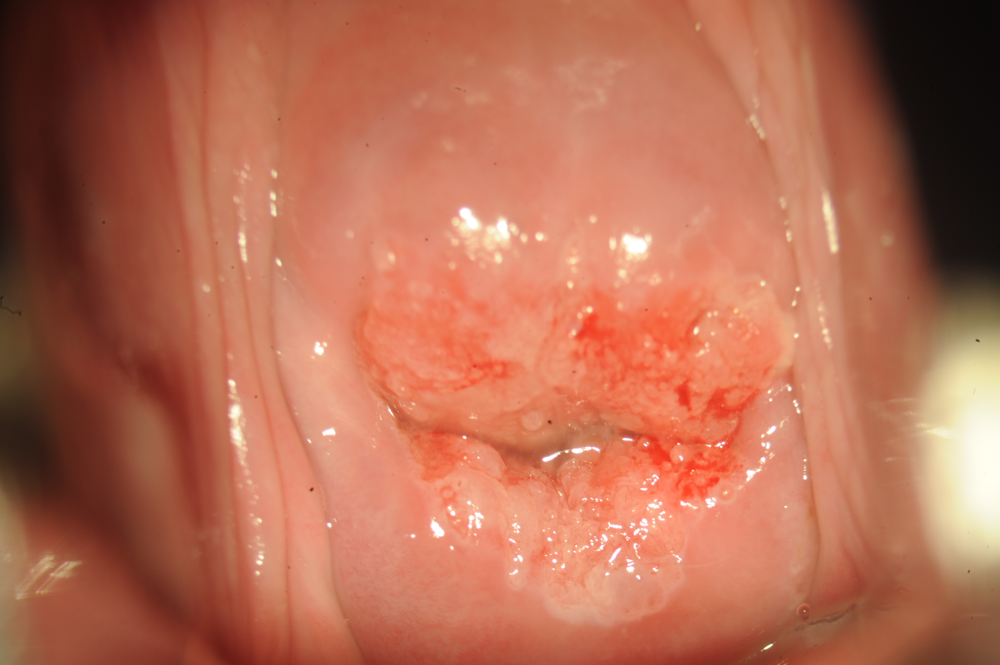

In [3]:
# Exploring our dataset

ds_path = '/sddata/projects/Cervical_Cancer_Projects/data/full_dataset_duke_liger_itoju_5StLowQual'
ds_path_images = os.listdir(ds_path)
print(f'Total number of images in full_dataset_duke_liger_itoju_5StLowQual: {len(ds_path_images)}')
ds_csv = '/sddata/projects/Cervical_Cancer_Projects/data/full_dataset_duke_liger_split_df.csv'
ds_df = pd.read_csv(ds_csv)
print(ds_df.head())
image_paths = [os.path.join(ds_path, name) for name in list(ds_df['MASKED_IMG_ID'])]
print(f'Len of dataset we are going to us: {len(image_paths)}')
image_paths
img = PImage.open(image_paths[random.randrange(len(image_paths))])
img

In [4]:
# Organize the dataset

# Filter rows where 'dataset' is 'train'
train_df = ds_df[ds_df['dataset'] == 'train']

# Filter rows where 'dataset' is 'val'
val_df = ds_df[ds_df['dataset'] == 'val']

# Extract the 'image' column from each DataFrame to get lists of image names
image_paths_train = train_df['MASKED_IMG_ID'].tolist()
image_paths_train = [os.path.join(ds_path, name) for name in image_paths_train]
label_paths_train = train_df['CC_ST'].tolist()

image_paths_validation = val_df['MASKED_IMG_ID'].tolist()
image_paths_validation = [os.path.join(ds_path, name) for name in image_paths_validation]
label_paths_validation = val_df['CC_ST'].tolist()

print(label_paths_validation[:5])

def create_dataset(image_paths, label_paths):
    dataset = Dataset.from_dict({"image": sorted(image_paths),
                                "label": sorted(label_paths)})
    dataset = dataset.cast_column("image", Image())
    # dataset = dataset.cast_column("label", torch.int32)

    return dataset

# step 1: create Dataset objects
train_dataset = create_dataset(image_paths_train, label_paths_train)
validation_dataset = create_dataset(image_paths_validation, label_paths_validation)

# step 2: create DatasetDict
dataset = DatasetDict({
    "train": train_dataset,
    "test": validation_dataset,
  }
)

dataset

[1.0, 0.0, 1.0, 0.0, 1.0]


DatasetDict({
    train: Dataset({
        features: ['image', 'label'],
        num_rows: 5669
    })
    test: Dataset({
        features: ['image', 'label'],
        num_rows: 924
    })
})

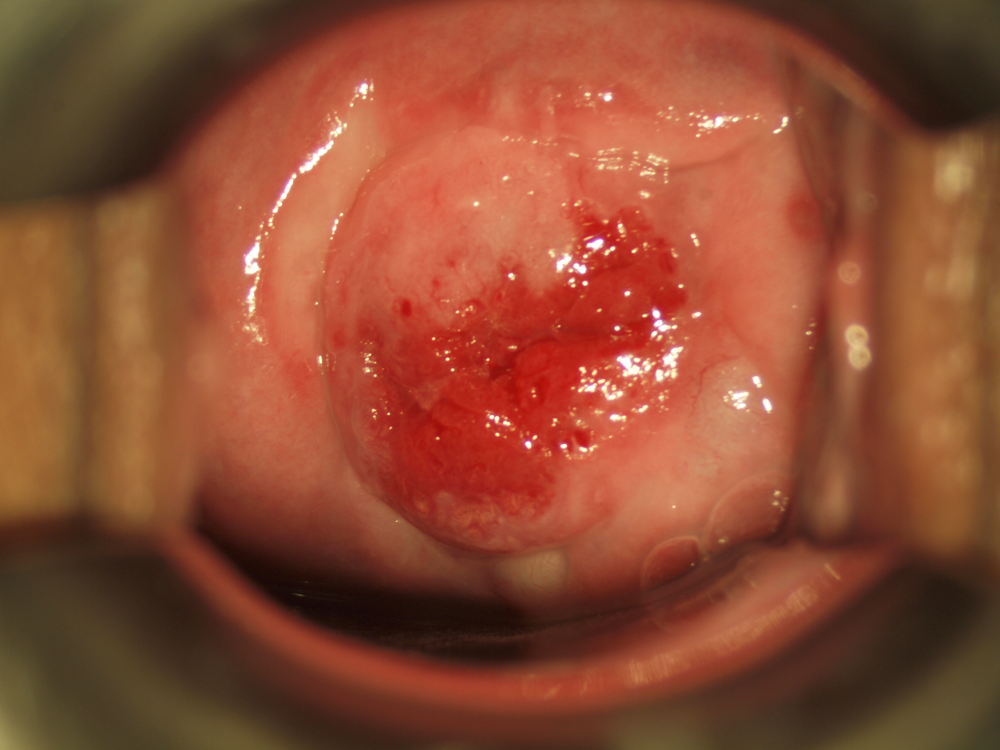

In [5]:
image = dataset['train'][0]['image']
image

In [6]:
label = dataset['train'][0]['label']
label

0.0

# Feature Extractor

In [7]:
from transformers import ViTFeatureExtractor

model_name_or_path = "facebook/vit-mae-base"
'''
From: https://huggingface.co/google/vit-base-patch16-224-in21k
'''
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)
feature_extractor

/usr/local/lib/python3.8/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


ViTFeatureExtractor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.485,
    0.456,
    0.406
  ],
  "image_processor_type": "ViTFeatureExtractor",
  "image_std": [
    0.229,
    0.224,
    0.225
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

In [8]:
from transformers import ViTFeatureExtractor

model_name_or_path = 'google/vit-base-patch16-224-in21k'
'''
From: https://huggingface.co/google/vit-base-patch16-224-in21k
'''
feature_extractor = ViTFeatureExtractor.from_pretrained(model_name_or_path)
feature_extractor

ViTFeatureExtractor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTFeatureExtractor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

In [9]:
feat_extracted_image = feature_extractor(image, return_tensors='pt')
print(feat_extracted_image)
print(feat_extracted_image['pixel_values'].shape)

{'pixel_values': tensor([[[[-0.0275, -0.0353, -0.0353,  ..., -0.4588, -0.4667, -0.4824],
          [-0.0275, -0.0275, -0.0353,  ..., -0.4510, -0.4588, -0.4745],
          [-0.0431, -0.0431, -0.0431,  ..., -0.4431, -0.4510, -0.4745],
          ...,
          [ 0.2549,  0.2000,  0.1294,  ..., -0.4510, -0.4667, -0.4824],
          [ 0.2706,  0.2157,  0.1529,  ..., -0.4588, -0.4667, -0.4824],
          [ 0.2863,  0.2392,  0.1765,  ..., -0.4588, -0.4745, -0.4824]],

         [[-0.1059, -0.0902, -0.0980,  ..., -0.5294, -0.5373, -0.5529],
          [-0.0980, -0.0902, -0.0980,  ..., -0.5216, -0.5294, -0.5451],
          [-0.0980, -0.0980, -0.0980,  ..., -0.5216, -0.5216, -0.5294],
          ...,
          [ 0.1451,  0.0902,  0.0275,  ..., -0.5137, -0.5216, -0.5216],
          [ 0.1608,  0.1137,  0.0510,  ..., -0.5059, -0.5216, -0.5294],
          [ 0.1686,  0.1294,  0.0667,  ..., -0.5137, -0.5137, -0.5216]],

         [[-0.4275, -0.4275, -0.4275,  ..., -0.7020, -0.7020, -0.7020],
          [-0

# Preprocessing

In [10]:
def process_example(example):
    inputs = feature_extractor(example['image'], return_tensors='pt')
    inputs['label'] = example['label']
    return inputs

In [11]:
process_example(dataset['train'][0])

{'pixel_values': tensor([[[[-0.0275, -0.0353, -0.0353,  ..., -0.4588, -0.4667, -0.4824],
          [-0.0275, -0.0275, -0.0353,  ..., -0.4510, -0.4588, -0.4745],
          [-0.0431, -0.0431, -0.0431,  ..., -0.4431, -0.4510, -0.4745],
          ...,
          [ 0.2549,  0.2000,  0.1294,  ..., -0.4510, -0.4667, -0.4824],
          [ 0.2706,  0.2157,  0.1529,  ..., -0.4588, -0.4667, -0.4824],
          [ 0.2863,  0.2392,  0.1765,  ..., -0.4588, -0.4745, -0.4824]],

         [[-0.1059, -0.0902, -0.0980,  ..., -0.5294, -0.5373, -0.5529],
          [-0.0980, -0.0902, -0.0980,  ..., -0.5216, -0.5294, -0.5451],
          [-0.0980, -0.0980, -0.0980,  ..., -0.5216, -0.5216, -0.5294],
          ...,
          [ 0.1451,  0.0902,  0.0275,  ..., -0.5137, -0.5216, -0.5216],
          [ 0.1608,  0.1137,  0.0510,  ..., -0.5059, -0.5216, -0.5294],
          [ 0.1686,  0.1294,  0.0667,  ..., -0.5137, -0.5137, -0.5216]],

         [[-0.4275, -0.4275, -0.4275,  ..., -0.7020, -0.7020, -0.7020],
          [-0

In [12]:
# Doing it all at once

def transform(example_batch):
    # Take a list of PIL images and turn them to pixel values
    inputs = feature_extractor([x for x in example_batch['image']], return_tensors='pt') # The same as above, but for everything in the batch

    # Don't forget to include the labels!
    inputs['label'] = example_batch['label']
    return inputs

In [13]:
prepared_ds = dataset.with_transform(transform)

In [25]:
prepared_ds['test'][0:2]['pixel_values'].shape

torch.Size([2, 3, 224, 224])

In [29]:
from monai.data import DataLoader
train_ds = prepared_ds['train']
val_ds = prepared_ds['test']
batch_size = 16
train_dataloader = DataLoader(train_ds, batch_size = batch_size, shuffle = False)
val_dataloader = DataLoader(val_ds, batch_size = batch_size, shuffle = False)

{'pixel_values': tensor([[[[-0.0275, -0.0353, -0.0353,  ..., -0.4588, -0.4667, -0.4824],
          [-0.0275, -0.0275, -0.0353,  ..., -0.4510, -0.4588, -0.4745],
          [-0.0431, -0.0431, -0.0431,  ..., -0.4431, -0.4510, -0.4745],
          ...,
          [ 0.2549,  0.2000,  0.1294,  ..., -0.4510, -0.4667, -0.4824],
          [ 0.2706,  0.2157,  0.1529,  ..., -0.4588, -0.4667, -0.4824],
          [ 0.2863,  0.2392,  0.1765,  ..., -0.4588, -0.4745, -0.4824]],

         [[-0.1059, -0.0902, -0.0980,  ..., -0.5294, -0.5373, -0.5529],
          [-0.0980, -0.0902, -0.0980,  ..., -0.5216, -0.5294, -0.5451],
          [-0.0980, -0.0980, -0.0980,  ..., -0.5216, -0.5216, -0.5294],
          ...,
          [ 0.1451,  0.0902,  0.0275,  ..., -0.5137, -0.5216, -0.5216],
          [ 0.1608,  0.1137,  0.0510,  ..., -0.5059, -0.5216, -0.5294],
          [ 0.1686,  0.1294,  0.0667,  ..., -0.5137, -0.5137, -0.5216]],

         [[-0.4275, -0.4275, -0.4275,  ..., -0.7020, -0.7020, -0.7020],
          [-0

KeyboardInterrupt: 

In [31]:
# Exploration of nn.CrossEntropyLoss()

from torch import nn as nn
loss = nn.CrossEntropyLoss()
input = torch.randn(3, 5, requires_grad=True)
print(input)
target = torch.empty(3, dtype=torch.long).random_(5)
print(target)
output = loss(input, target)
output.backward()

tensor([[-0.2788,  0.1863,  1.6273,  1.1214, -0.6605],
        [-0.0131,  1.5860, -1.0186, -0.4180, -0.2935],
        [ 1.4329,  0.5312, -0.2483, -0.1735,  1.3850]], requires_grad=True)
tensor([1, 3, 0])


## Collating

In [15]:
import torch

def collate_fn(batch):
    return {
        'pixel_values': torch.stack([x['pixel_values'] for x in batch]),
        'label': torch.tensor([x['label'] for x in batch])
    }

# Evaluation Metric

In [16]:
import numpy as np
from datasets import load_metric

metric = load_metric("accuracy")
def compute_metrics(p):
    return metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)

/tmp/ipykernel_347614/2425197347.py:4: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  metric = load_metric("accuracy")


In [17]:
from transformers import ViTForImageClassification

# labels = dataset['train'].features['label']

model = ViTForImageClassification.from_pretrained(
    model_name_or_path,
    num_labels=3
)

/usr/local/lib/python3.8/dist-packages/torch/cuda/__init__.py:546: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
Some weights of ViTForImageClassification were not initialized from the model checkpoint at google/vit-base-patch16-224-in21k and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


# Training Arguments

In [18]:
from transformers import TrainingArguments

training_args = TrainingArguments(
  output_dir="./vit-base-cervix",
  per_device_train_batch_size=16,
  evaluation_strategy="steps",
  num_train_epochs=4,
  fp16=False,
  save_steps=100,
  eval_steps=100,
  logging_steps=10,
  learning_rate=2e-4,
  save_total_limit=2,
  remove_unused_columns=False,
  push_to_hub=False,
  report_to='tensorboard',
  load_best_model_at_end=True,
)

# Training Loop

In [19]:
from transformers import Trainer

trainer = Trainer(
    model=model,
    args=training_args,
    data_collator=collate_fn,
    compute_metrics=compute_metrics,
    train_dataset=prepared_ds["train"],
    eval_dataset=prepared_ds["test"],
    tokenizer=feature_extractor,
)

In [20]:
train_results = trainer.train()
trainer.save_model()
trainer.log_metrics("train", train_results.metrics)
trainer.save_metrics("train", train_results.metrics)
trainer.save_state()

TypeError: forward() got an unexpected keyword argument 'label'